# Summary

```Objective```

todo

```Methods```

todo

```Results```

todo

# Config

# Libs

In [4]:
import numpy as np
import torch
import torchio as tio
import torchio.transforms as transforms
import matplotlib.pyplot as plt
import math
import h5py
from scipy.fft import fftn, ifftn, fftshift, ifftshift
from misalign.data.Kaggle_datamodule import KaggleDataModule
from misalign.draw import blend_and_transpose

def show_img(img):
    plt.figure(dpi=150)
    im = plt.imshow(img, cmap='gray')
    cbar = plt.colorbar(im, shrink=0.5)
    im.set_clim(vmin=-1, vmax=1)
    plt.xticks([])
    plt.yticks([])
    plt.show()

In [6]:
misalign_x = 0
misalign_y = 0
degree = 0
motion_prob = 0
deform_prob = 0

_ = KaggleDataModule('C:/Users/NUGURI/Workspace/misalign-benchmark/data/Kaggle', misalign_x=misalign_x, misalign_y=misalign_y, degree=degree, motion_prob=motion_prob, deform_prob=deform_prob)
_.prepare_data()


path exists for C:/Users/NUGURI/Workspace/misalign-benchmark/data/Kaggle\val\prepared_data_0.0_0.0_0.0_0.0_0.0.h5
path exists for C:/Users/NUGURI/Workspace/misalign-benchmark/data/Kaggle\test\prepared_data_0.0_0.0_0.0_0.0_0.0.h5


torch.Size([64, 1, 256, 256]) torch.Size([64, 1, 256, 256])


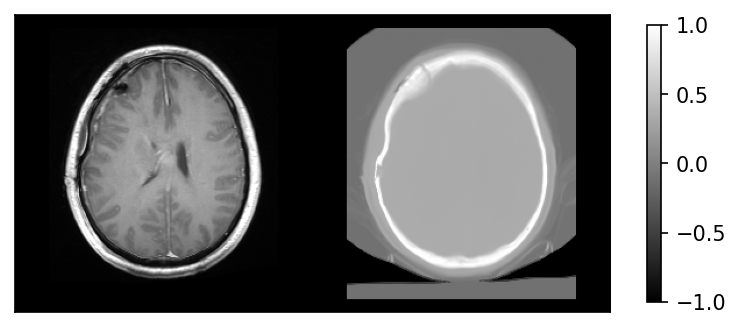

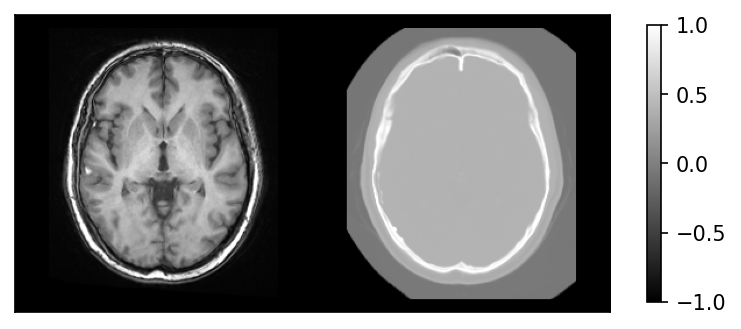

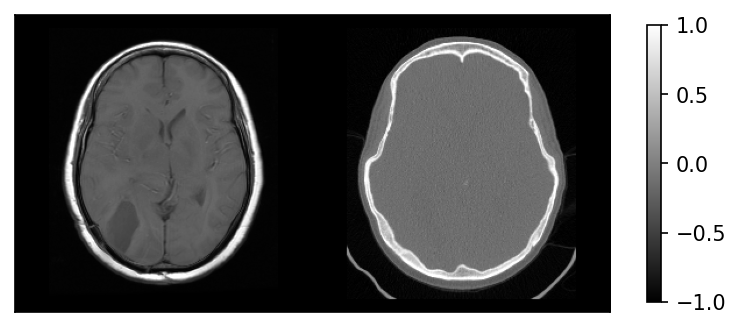

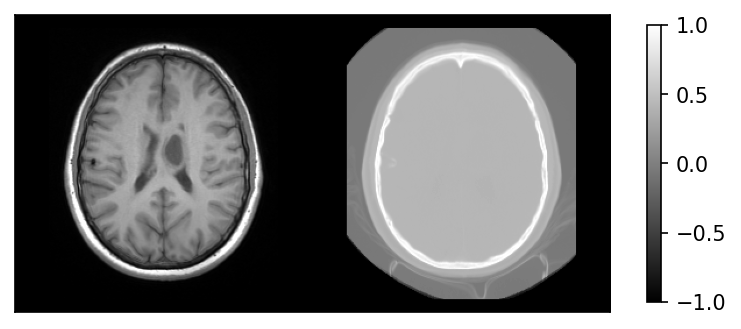

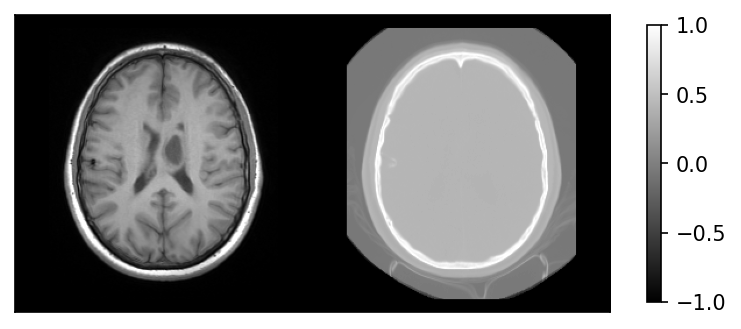

...

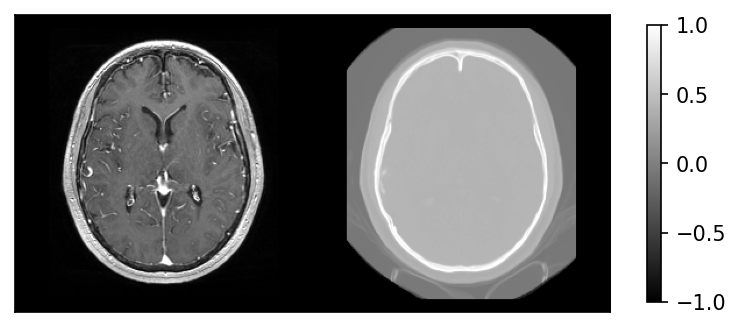

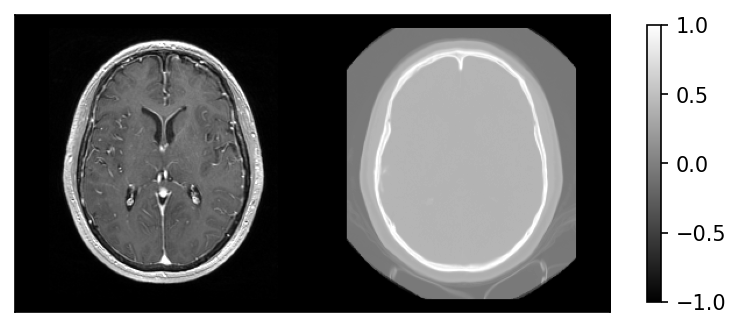

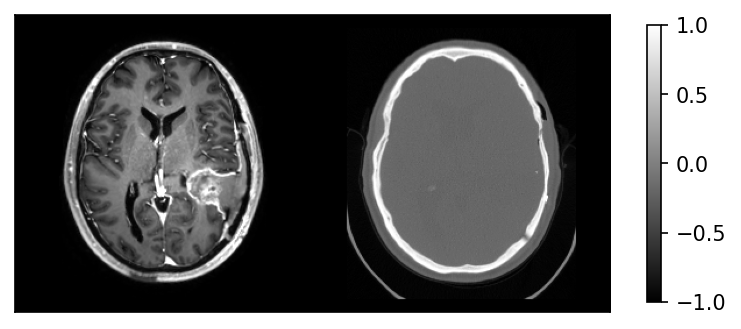

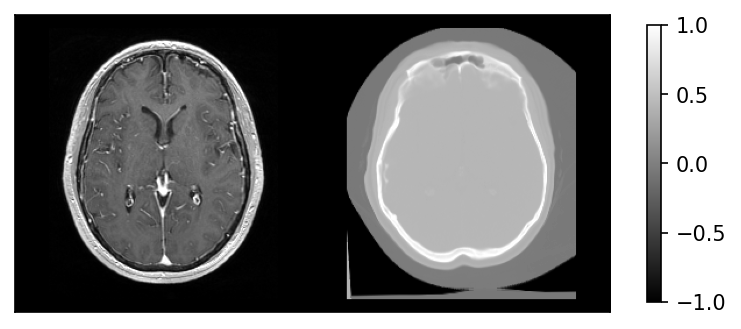

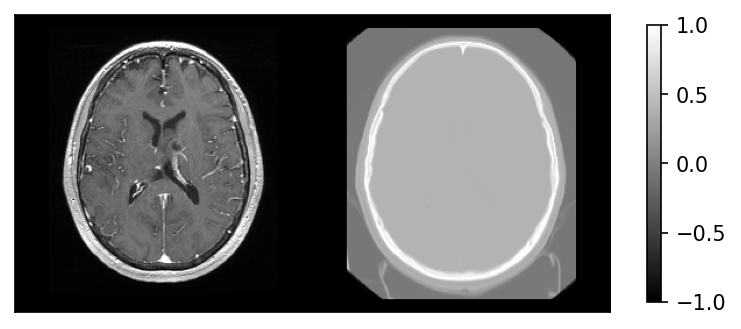

In [7]:
_.setup()
train_data = _.train_dataloader()

for a, b in train_data:
    print(a.shape, b.shape)
    break

for _a, _b in zip(a,b):
    # blended_img = blend_and_transpose(_a[0], _b[0])
    show_img(np.concatenate((_a[0], _b[0]),1))

# Analysis

(570, 256, 256)


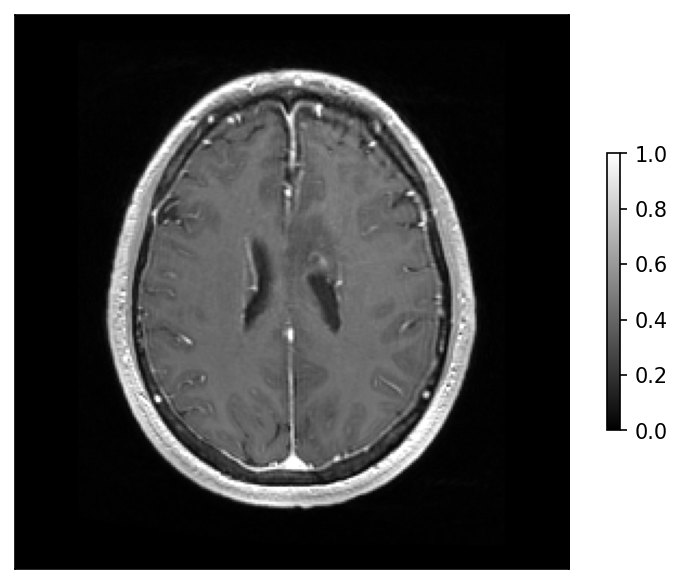

In [60]:
dataroot = 'C:/Users/NUGURI/Workspace/misalign-benchmark/data/Kaggle/train/train_input.npy'
raw_MRI = np.load(dataroot)
raw_MRI = np.transpose(raw_MRI, [2,1,0])
raw_MRI = np.flipud(raw_MRI)
raw_MRI = np.transpose(raw_MRI, [2,0,1])
print(raw_MRI.shape)

zz = 50
show_img(raw_MRI[zz,:,:])

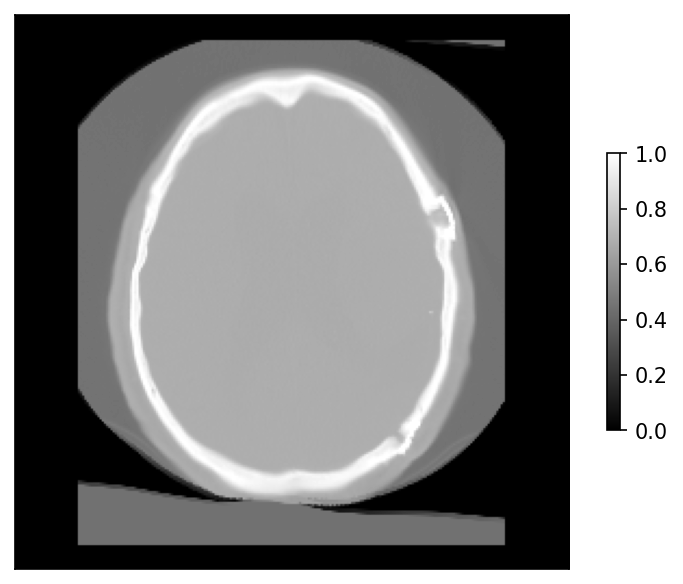

In [38]:
dataroot = 'C:/Users/NUGURI/Workspace/misalign-benchmark/data/Kaggle/val/val_output.npy'
raw_CT = np.load(dataroot)
raw_CT = np.transpose(raw_CT, [2,1,0])
raw_CT = np.flipud(raw_CT)

zz = 50
show_img(raw_CT[:,:,zz])

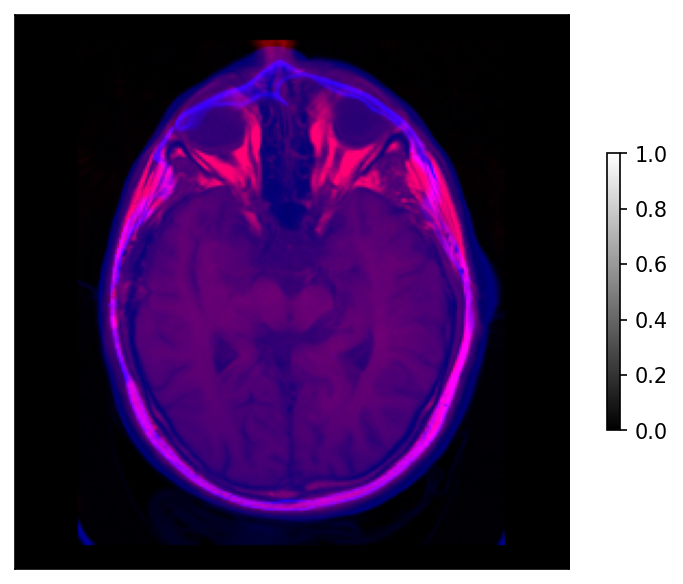

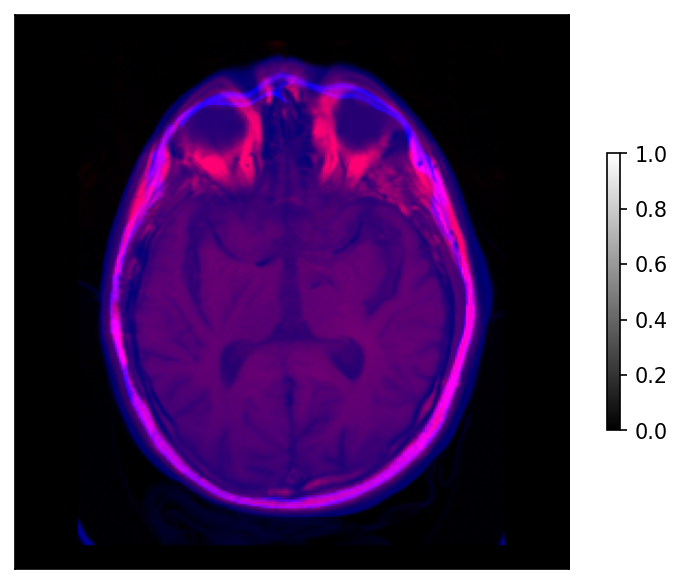

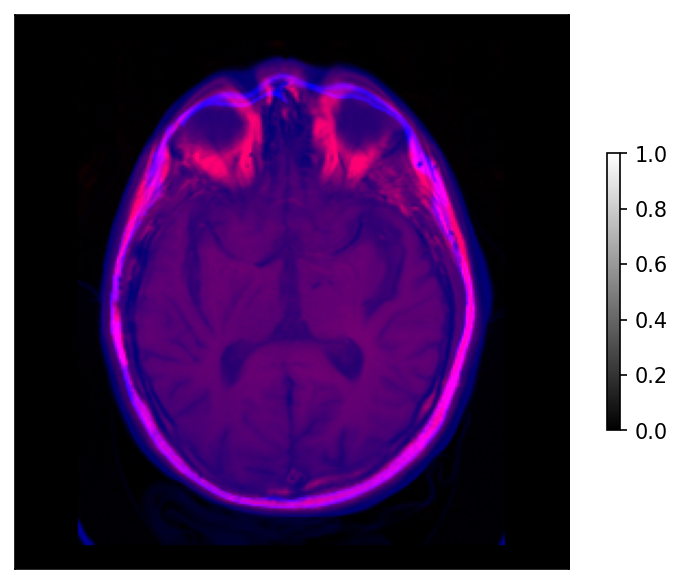

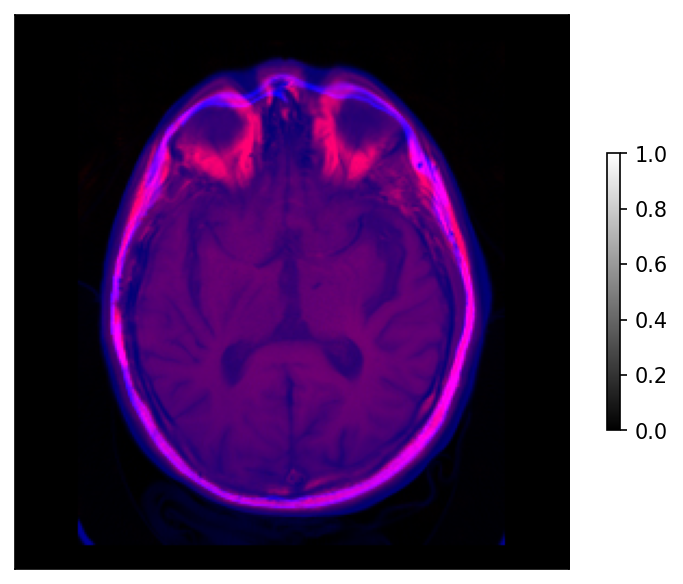

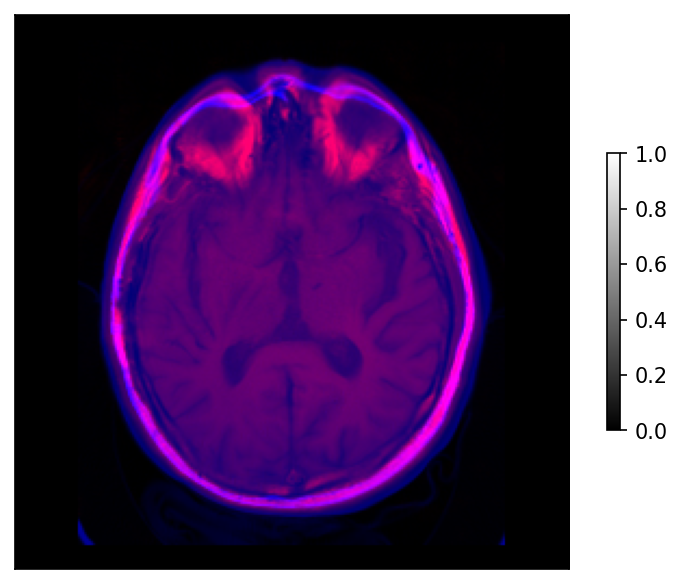

...

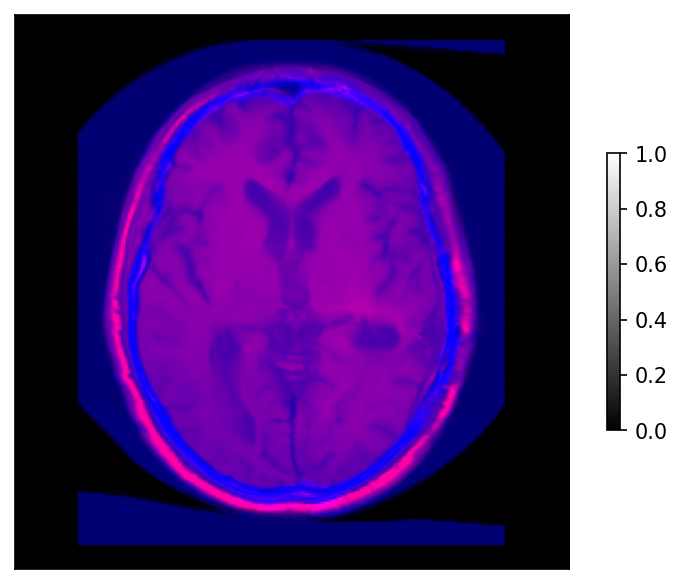

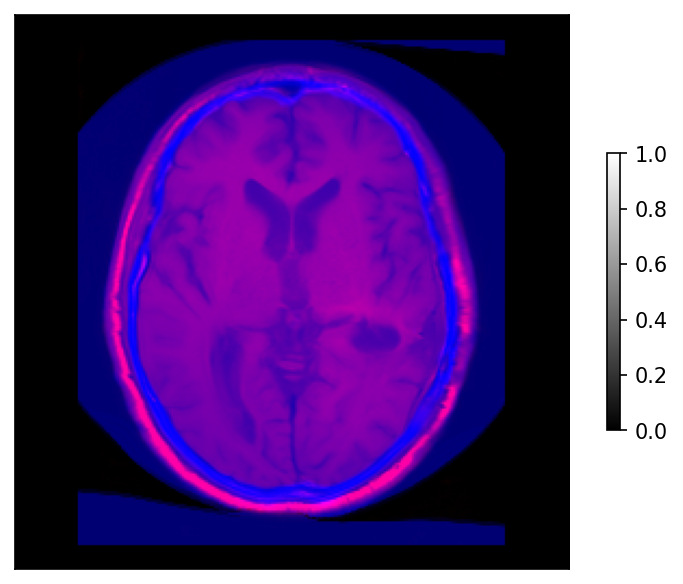

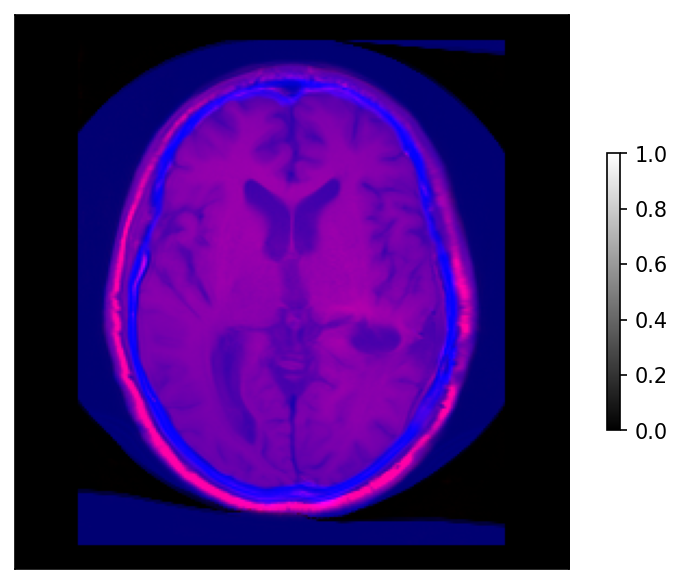

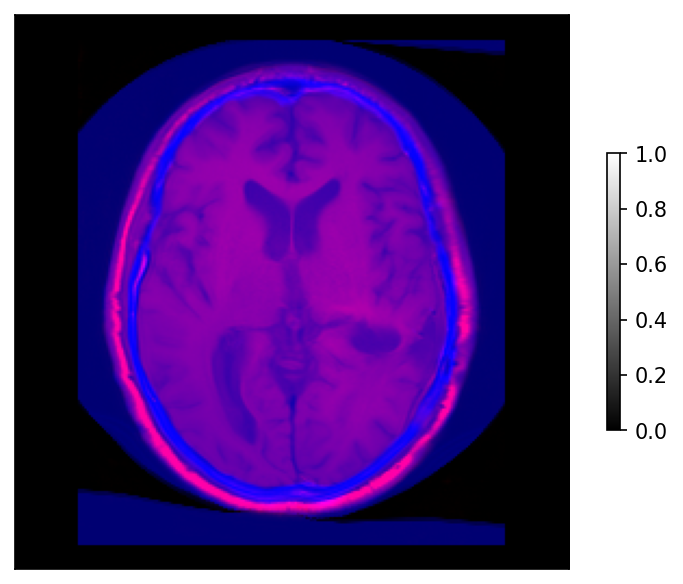

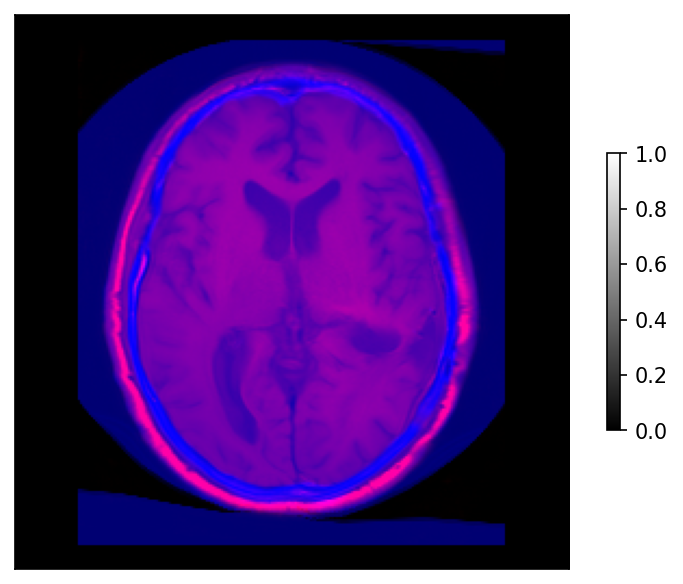

In [40]:
for ii in range(0,90):
    blended_image = np.zeros((256, 256, 3))
    blended_image[:, :, 0] = raw_MRI[:,:,ii]  # 빨간색 채널에 MRI
    blended_image[:, :, 2] = raw_CT[:,:,ii]  # 파란색 채널에 CT
    show_img(blended_image)


In [10]:
import numpy as np
import h5py

dataroot = 'C:/Users/NUGURI/Workspace/misalign-benchmark/data/Kaggle/test/test_input.npy'
raw_MRI = np.load(dataroot)

dataroot = 'C:/Users/NUGURI/Workspace/misalign-benchmark/data/Kaggle/test/test_output.npy'
raw_CT = np.load(dataroot)

print('MRI: ', raw_MRI.shape)
print('CT: ', raw_CT.shape)

MRI:  (150, 256, 256)
CT:  (150, 256, 256)


In [11]:
# HDF5 파일로 저장하기
hdf5_file_path = 'C:/Users/NUGURI/Workspace/misalign-benchmark/data/Kaggle/test/data.mat'
with h5py.File(hdf5_file_path, 'w') as file:
    file.create_dataset('data_x', data=raw_MRI)
    file.create_dataset('data_y', data=raw_CT)

print("Data successfully saved as HDF5 file.")

Data successfully saved as HDF5 file.


<KeysViewHDF5 ['data_x', 'data_y']>
MRI size: (570, 256, 256)
CT size: (570, 256, 256)


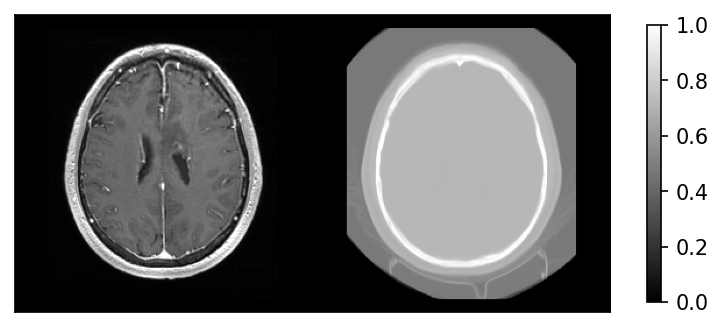

In [19]:
dataroot = 'C:/Users/NUGURI/Workspace/misalign-benchmark/data/Kaggle/train/data.mat'
mat = h5py.File(dataroot, 'r')
print(mat.keys())

raw_MRI = np.array(mat['data_x'])
raw_MRI = np.transpose(raw_MRI, [2,1,0])
raw_MRI = np.flipud(raw_MRI)
raw_MRI = np.transpose(raw_MRI, [2,0,1])

raw_CT = np.array(mat['data_y'])
raw_CT = np.transpose(raw_CT, [2,1,0])
raw_CT = np.flipud(raw_CT)
raw_CT = np.transpose(raw_CT, [2,0,1])

print('MRI size:', raw_MRI.shape)
print('CT size:', raw_CT.shape)
mat.close()

zz = 50
show_img(np.concatenate((raw_MRI[zz,:,:], raw_CT[zz,:,:]),1))

data_A:  (1, 570, 256, 256)
data_B:  (1, 570, 256, 256)


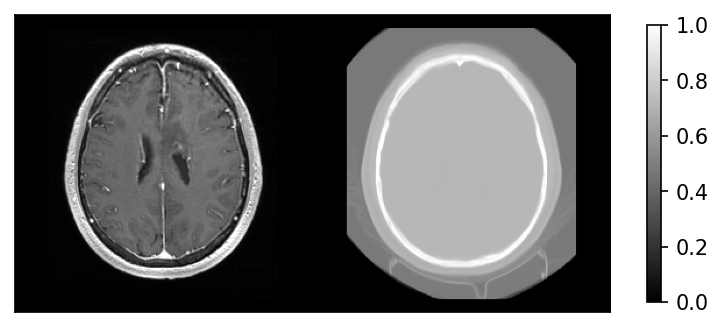

In [3]:
import h5py
data_dir = 'C:/Users/NUGURI/Workspace/misalign-benchmark/data/Kaggle/train/data.mat'

with h5py.File(data_dir, "r") as f:
    data_A = np.array(f["data_x"])
    data_B = np.array(f["data_y"])

# create torch tensors
data_A = np.transpose(data_A, (2, 1, 0))
data_A = np.flipud(data_A)
data_A = np.transpose(data_A, [2,0,1])
data_A = np.expand_dims(data_A, axis=0)
print('data_A: ', data_A.shape)

data_B = np.transpose(data_B, (2, 1, 0))
data_B = np.flipud(data_B)
data_B = np.transpose(data_B, [2,0,1])
data_B = np.expand_dims(data_B, axis=0)
print('data_B: ', data_B.shape)

zz = 50
show_img(np.concatenate((data_A[:,zz,:,:].squeeze(), data_B[:,zz,:,:].squeeze()),1))

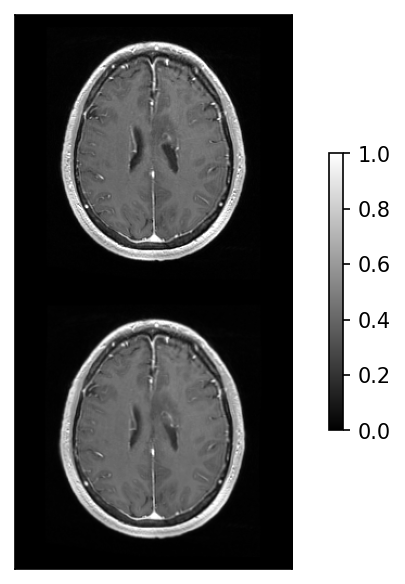

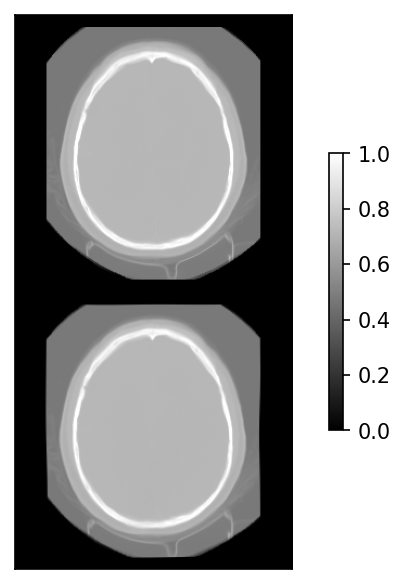

In [13]:
torch.manual_seed(50)
elastic_transform = tio.transforms.RandomElasticDeformation(
    num_control_points=9,  # 제어점의 수 설정
    max_displacement=5,  # 최대 이동 범위 설정
)

elastic_T1 = elastic_transform(data_A.copy()).squeeze()
elastic_T2 = elastic_transform(data_B.copy()).squeeze()

zz = 50
show_img(np.concatenate((data_A[:,zz,:,:].squeeze(), elastic_T1[zz,:,:].squeeze()),0))
show_img(np.concatenate((data_B[:,zz,:,:].squeeze(), elastic_T2[zz,:,:].squeeze()),0))